In [29]:
import cv2
import numpy as np

In [30]:
image = cv2.imread("/content/cv_image .jpeg")

An affine transformation in computer vision refers to a linear mapping that preserves points, straight lines, and planes. It can include operations such as rotation, translation (shifting), scaling (resizing), and shearing (skewing).

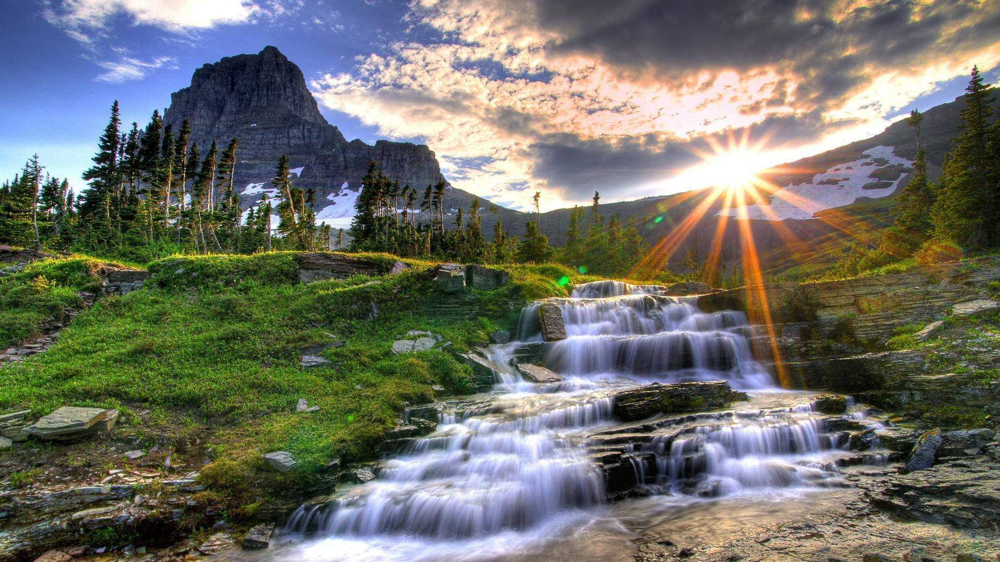

In [31]:
from google.colab.patches import cv2_imshow
cv2_imshow(image)

# translation (shifting)

In [32]:
# Define translation matrix for shifting image
tx = 50
ty = 30
translation_matrix = np.float32([[1, 0, tx],
                                 [0, 1, ty]])

In [33]:
translated_image = cv2.warpAffine(image, translation_matrix, (image.shape[1], image.shape[0]))

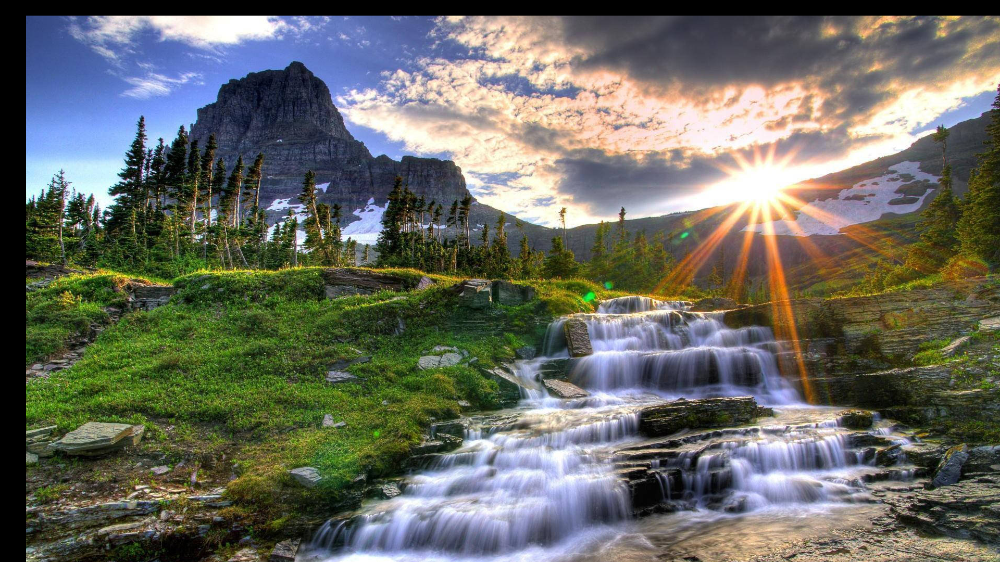

In [34]:
cv2_imshow(translated_image)


# Rotation

In [35]:
# Define rotation matrix for rotating image
angle = 45  # Angle in degrees
rotation_matrix = cv2.getRotationMatrix2D(center=(image.shape[1] / 2, image.shape[0] / 2), angle=angle, scale=1)


In [36]:
rotated_image = cv2.warpAffine(image, rotation_matrix, (image.shape[1], image.shape[0]))

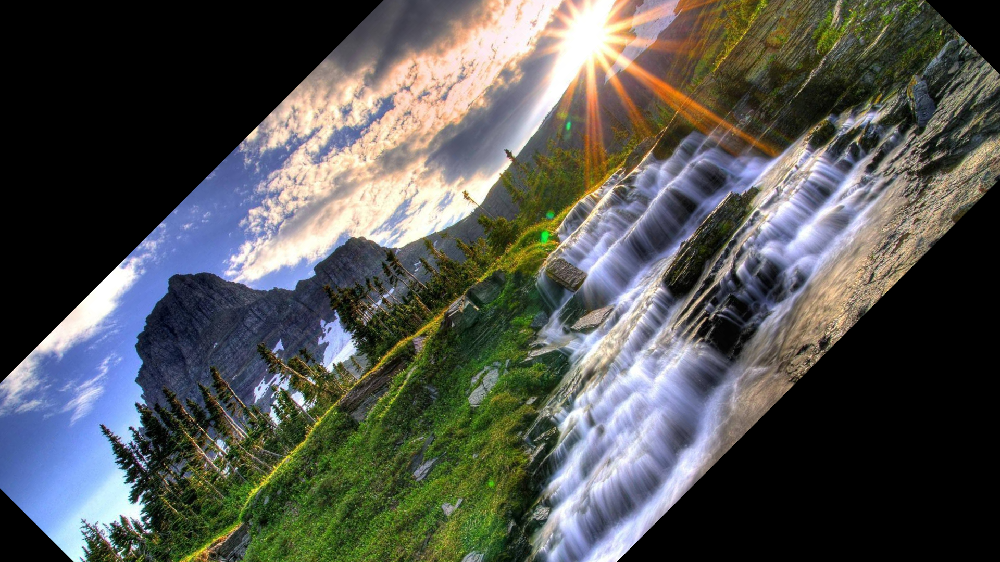

In [37]:
cv2_imshow(rotated_image)

# scaling (resizing)

In [38]:
# Define scaling matrix for scaling image
scale_factor_x = 1.5
scale_factor_y = 1.5
scaling_matrix = np.float32([[scale_factor_x, 0, 0],
                             [0, scale_factor_y, 0]])

In [39]:
scaled_image = cv2.warpAffine(image, scaling_matrix, (image.shape[1], image.shape[0]))


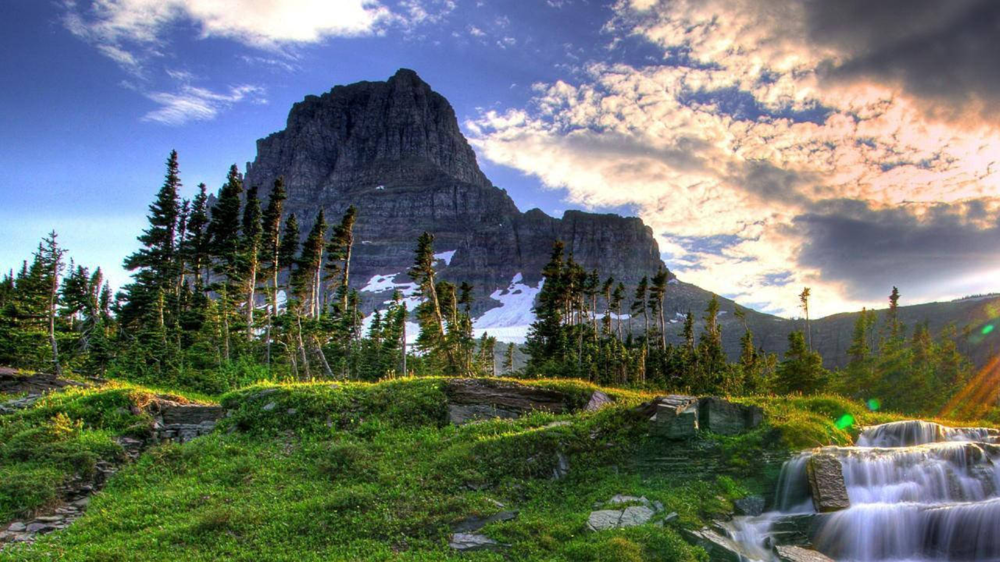

In [40]:
cv2_imshow(scaled_image)

# shearing (skewing)

In [41]:
# Define shearing matrix for shearing image
shx = 0.5
shy = 0.2
shearing_matrix = np.float32([[1, shx, 0],
                              [shy, 1, 0]])

In [42]:
sheared_image = cv2.warpAffine(image, shearing_matrix, (image.shape[1], image.shape[0]))


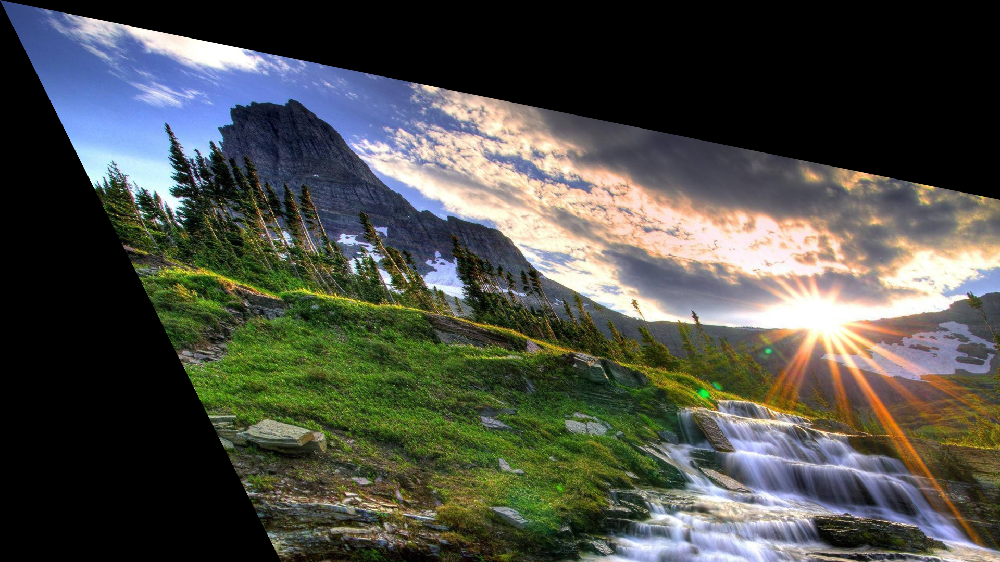

In [43]:
cv2_imshow(sheared_image)

###Transformations using scipy

In [44]:
# All Geometric transformations
import numpy as np
from scipy import ndimage as ndi
from skimage.io import imread
#Scikit-image, or skimage, is an open source Python package designed for image preprocessing.
from skimage.color import rgb2gray
import matplotlib.pyplot as plt



In [45]:
#read and convert the iamge in to gray
img = rgb2gray(imread('/content/cv_image .jpeg'))
w, h = img.shape



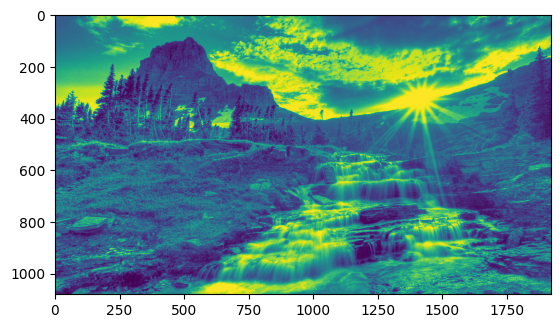

In [46]:
#Apply identity transform:
mat_identity = np.array([[1,0,0],[0,1,0],[0,0,1]])
img1 = ndi.affine_transform(img, mat_identity)
plt.imshow(img1)


In [47]:
#Apply reflection transform :

# Translation
tx,ty=50,50
mat_translate = np.array([[1,0,tx],[0,1,ty],[0,0,1]])
img9 = ndi.affine_transform(img, mat_translate) # offset=(0,h)

#Scale the image (0.75 times along the x axis and 1.25 times along the y axis):
s_x, s_y = 0.75, 0.75
mat_scale = np.array([[s_x,0,0],[0,s_y,0],[0,0,1]])
img3 = ndi.affine_transform(img, mat_scale)
#plt.imshow(img1)



In [48]:
#Rotate the image by 30° counter-clockwise.
#It's a composite operation—first, you will need to shift/center the image, apply rotation, and then apply inverse shift:
theta = np.pi/6
mat_rotate = np.array([[1,0,w/2],[0,1,h/2],[0,0,1]])
np.array([[np.cos(theta),np.sin(theta),0],[np.sin(theta),-np.cos(theta),0],[0,0,1]]) @ np.array([[1,0,-w/2],[0,1,-h/2],[0,0,1]])
img4 = ndi.affine_transform(img1, mat_rotate)

mat_reflect = np.array([[1,0,0],[0,-1,0],[0,0,1]]) @ np.array([[1,0,0],[0,1,-h],[0,0,1]])
img2 = ndi.affine_transform(img, mat_reflect) # offset=(0,h)

#Apply shear transform to the image:
lambda1 = 0.5
mat_shear = np.array([[1,lambda1,0],[lambda1,1,0],[0,0,1]])
img5 = ndi.affine_transform(img1, mat_shear)



Text(0.5, 1.0, 'Translated image')

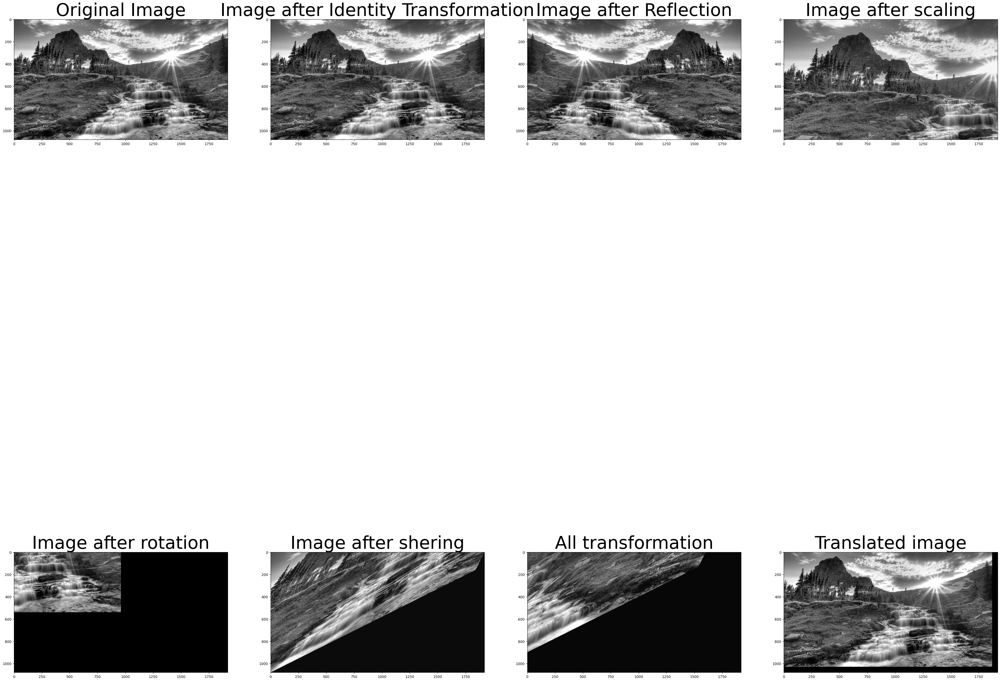

In [52]:
#Finally apply all of the transforms together, in sequence:

mat_all = mat_identity @ mat_reflect @ mat_scale @ mat_rotate @ mat_shear
final=ndi.affine_transform(img, mat_all)

fig, ax = plt.subplots(nrows=2, ncols=4, figsize=(50, 50))
ax[0, 0].imshow(img,"gray")
ax[0, 0].set_title('Original Image',fontsize = 50)
ax[0, 1].imshow(img1,"gray")
ax[0, 1].set_title('Image after Identity Transformation',fontsize = 50)
ax[0, 2].imshow(img2, "gray")
ax[0, 2].set_title('Image after Reflection',fontsize = 50)
ax[0, 3].imshow(img3, "gray")

ax[0, 3].set_title('Image after scaling',fontsize = 50)

ax[1, 0].imshow(img4, "gray")

ax[1, 0].set_title('Image after rotation',fontsize = 50)
ax[1, 1].imshow(img5, "gray")

ax[1, 1].set_title('Image after shering',fontsize = 50)
ax[1, 2].imshow(final, "gray")

ax[1, 2].set_title('All transformation',fontsize = 50)

ax[1, 3].imshow(img9,"gray")

ax[1, 3].set_title('Translated image',fontsize = 50)